<a href="https://colab.research.google.com/github/ryanczhang7/spotifyproject/blob/master/Spotify_EDA_and_Visualizations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Getting the notebooks

In [0]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy import stats

In [0]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

**Songs contains spotify data and audio features. Complete songs contains the songs in songs that I was able to scrape lyrics for and also contains sentiment and personality analysis for those lyrics.**

In [0]:
df_personality_sentiment = pd.read_csv(
    "/content/drive/My Drive/df_personality_sentiment.csv")
df_songs = pd.read_csv("/content/drive/My Drive/df_songs.csv")

In [10]:
df_songs

,artist,album,name,explicit,key,mode,time_signature,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,genre,duration_s
0,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Black Panther,1,1,1,4,0.6250,0.618,0.582,0.000004,0.2650,-9.454,0.2970,90.035,0.480,57,hiphop,130.613
1,Kendrick Lamar,Black Panther The Album Music From And Inspire...,All The Stars,1,8,1,4,0.0605,0.698,0.633,0.000194,0.0926,-4.946,0.0597,96.924,0.552,78,hiphop,232.186
2,Kendrick Lamar,Black Panther The Album Music From And Inspire...,X,1,2,1,4,0.0201,0.768,0.471,0.000000,0.2680,-8.406,0.2590,131.023,0.405,69,hiphop,267.426
3,Kendrick Lamar,Black Panther The Album Music From And Inspire...,The Ways,1,11,0,4,0.0626,0.727,0.720,0.000001,0.1760,-5.856,0.0488,140.080,0.589,65,hiphop,238.893
4,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Opps,1,1,1,4,0.1520,0.706,0.775,0.000033,0.4160,-6.819,0.3350,127.929,0.847,59,hiphop,180.893
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1043,Halsey,BADLANDS (Deluxe),Haunting,0,9,0,4,0.0150,0.461,0.696,0.000491,0.2100,-5.752,0.0486,180.006,0.311,59,pop,260.797
1044,Halsey,BADLANDS (Deluxe),Gasoline,1,10,0,4,0.2230,0.731,0.580,0.000000,0.1290,-7.328,0.0399,119.997,0.319,72,pop,199.593
1045,Halsey,BADLANDS (Deluxe),Control,0,4,0,4,0.3990,0.549,0.675,0.000000,0.1810,-5.637,0.0332,119.898,0.206,69,pop,214.761
1046,Halsey,BADLANDS (Deluxe),Young God,1,9,0,4,0.3240,0.449,0.599,0.000004,0.1140,-6.509,0.0405,119.868,0.198,60,pop,180.088


In [11]:
df_personality_sentiment

,artist,album,name,explicit,genre,chain_lyrics,lyrics,polarity,magnitude,artistic,emotion,imagination,assertive,cheeful,outgoing,modesty,sympathy,fiery,melancholy
0,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Black Panther,1,hiphop,why i go easy \n know why i go easy \n wait \n...,why i go easy know why i go easy wait king of ...,-1.0,1.2,0.999983,0.931594,0.998384,0.095272,0.387043,0.101374,0.421143,0.985013,0.386352,0.921542
1,Kendrick Lamar,Black Panther The Album Music From And Inspire...,All The Stars,1,hiphop,love lets talk about love \n is it anything an...,love lets talk about love is it anything and e...,-1.0,1.3,0.996511,0.986234,0.991554,0.747748,0.986040,0.705842,0.441873,0.842244,0.157679,0.626636
2,Kendrick Lamar,Black Panther The Album Music From And Inspire...,I Am,1,hiphop,everybody put three fingers in the air \n the ...,everybody put three fingers in the air the sky...,-1.0,2.2,0.906971,0.318395,0.994980,0.574279,0.469771,0.320161,0.024560,0.785487,0.582447,0.669157
3,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Big Shot,1,hiphop,wakanda welcome \n big shot hol up wait peanut...,wakanda welcome big shot hol up wait peanut bu...,-1.0,1.3,0.967339,0.229457,0.975867,0.382183,0.880943,0.477181,0.000747,0.270318,0.787414,0.197281
4,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Pray For Me,1,hiphop,im always ready for a war again \n go down tha...,im always ready for a war again go down that r...,-1.0,1.1,0.980110,0.889895,0.977369,0.307116,0.962168,0.668731,0.864149,0.875111,0.464351,0.871338
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,Halsey,BADLANDS (Deluxe),Haunting,0,pop,keep on haunting \n keep on haunting me \n kee...,keep on haunting keep on haunting me keep on h...,-1.0,1.4,0.930841,0.915972,0.965041,0.019663,0.737102,0.104255,0.964988,0.768947,0.798722,0.982352
817,Halsey,BADLANDS (Deluxe),Gasoline,1,pop,are you insane like me been in pain like me \n...,are you insane like me been in pain like me bo...,-1.0,1.0,0.988442,0.748622,0.999587,0.672225,0.720852,0.430028,0.083116,0.693261,0.935605,0.962687
818,Halsey,BADLANDS (Deluxe),Control,0,pop,they send me away to find them a fortune \n a ...,they send me away to find them a fortune a che...,-1.0,1.7,0.995897,0.990308,0.999998,0.062743,0.096730,0.006704,0.654713,0.966235,0.990844,0.999999
819,Halsey,BADLANDS (Deluxe),Young God,1,pop,he says oh baby girl you know were gonna be le...,he says oh baby girl you know were gonna be le...,0.2,1.1,0.974639,0.804268,0.934779,0.226985,0.578715,0.297378,0.678562,0.892613,0.147212,0.884749


# Visualizations and Analysis of All Songs

In [12]:
df_songs.describe()

,explicit,key,mode,time_signature,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,duration_s
count,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000
mean,0.418893,5.312977,0.571565,3.945611,0.292851,0.631814,0.578507,0.016234,0.199163,-7.566540,0.156018,115.426849,0.429565,51.113550,224.020895
std,0.493613,3.685246,0.495088,0.373297,0.278955,0.140146,0.184954,0.092074,0.159227,2.848242,0.151260,29.879438,0.210998,20.347447,68.051469
min,0.000000,0.000000,0.000000,0.000000,0.000197,0.000000,0.034600,0.000000,0.024800,-23.023000,0.000000,0.000000,0.000000,0.000000,13.578000
25%,0.000000,1.000000,0.000000,4.000000,0.052650,0.545000,0.458000,0.000000,0.102000,-8.813750,0.044000,92.077500,0.275750,40.000000,191.166250
50%,0.000000,6.000000,1.000000,4.000000,0.193500,0.641000,0.584000,0.000000,0.132000,-6.950500,0.087300,110.025000,0.411000,56.000000,217.313000
75%,1.000000,9.000000,1.000000,4.000000,0.495750,0.735000,0.717000,0.000060,0.246000,-5.659500,0.239000,135.098750,0.569000,66.000000,251.199250
max,1.000000,11.000000,1.000000,5.000000,0.988000,0.968000,0.952000,0.942000,0.948000,-1.644000,0.912000,207.476000,0.977000,93.000000,875.306000


**Thanks to Simon Brugman and collaborators for their pandas-profiling project on Github, which makes EDA very efficient and clean.**

In [21]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df_songs, title='Pandas Profiling Report', 
                        html={'style':{'full_width':True}})

In [8]:
profile.to_notebook_iframe()

**Taking a look at scatter plots between some features that had high correlation from above.**

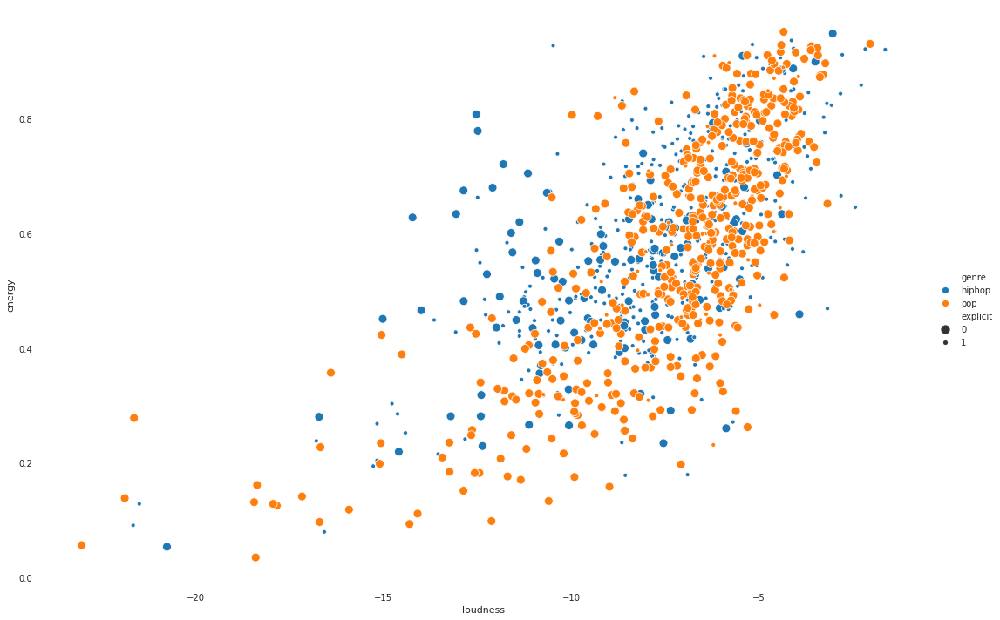

In [17]:
sns.relplot(x="loudness", y="energy", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_songs)

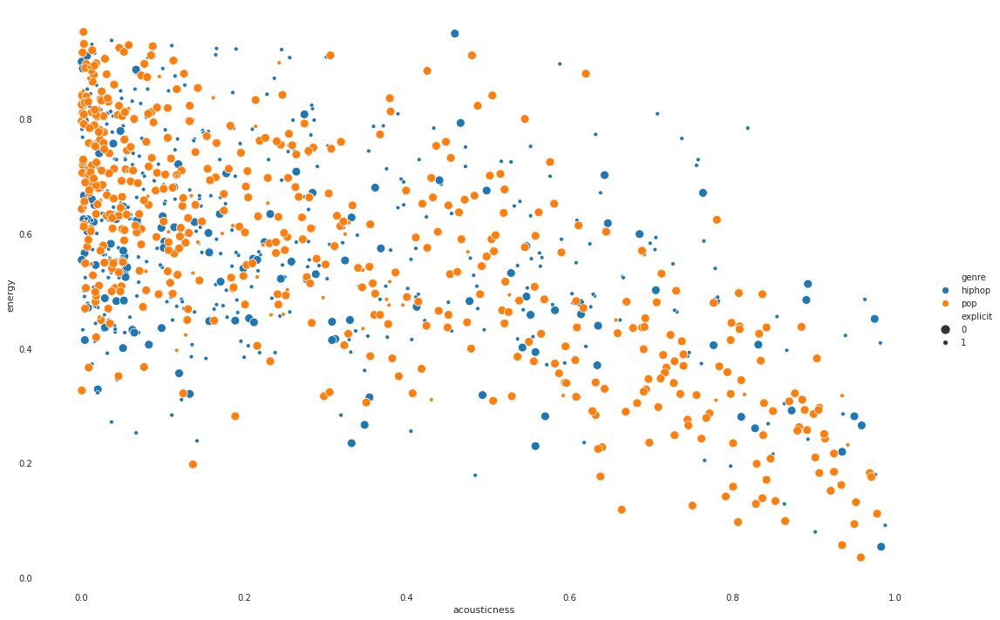

In [18]:
sns.relplot(x="acousticness", y="energy", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_songs)

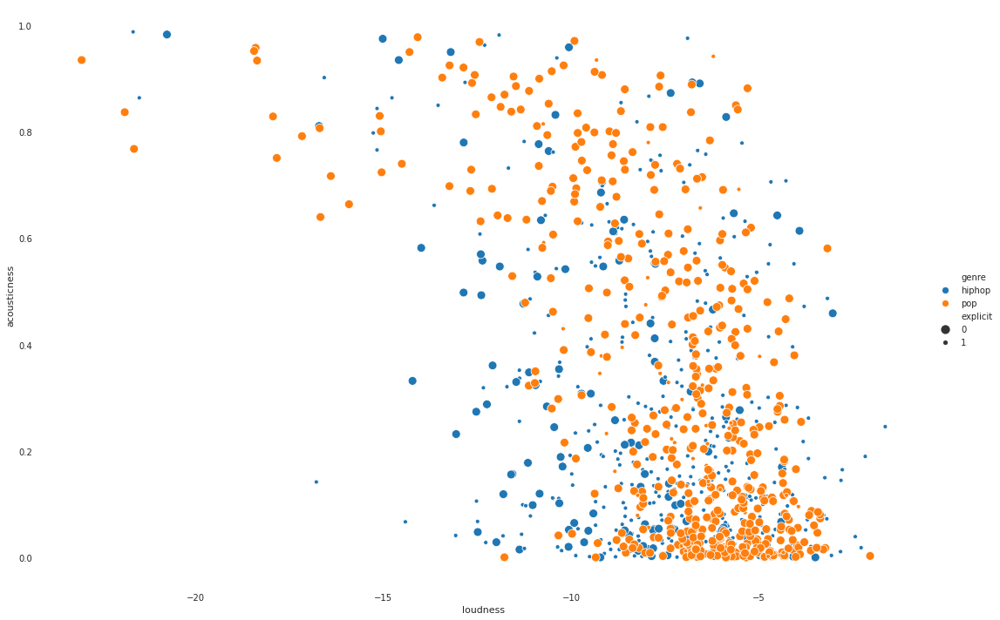

In [19]:
sns.relplot(x="loudness", y="acousticness", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_songs)

**Popularity of songs by artist and genre.**

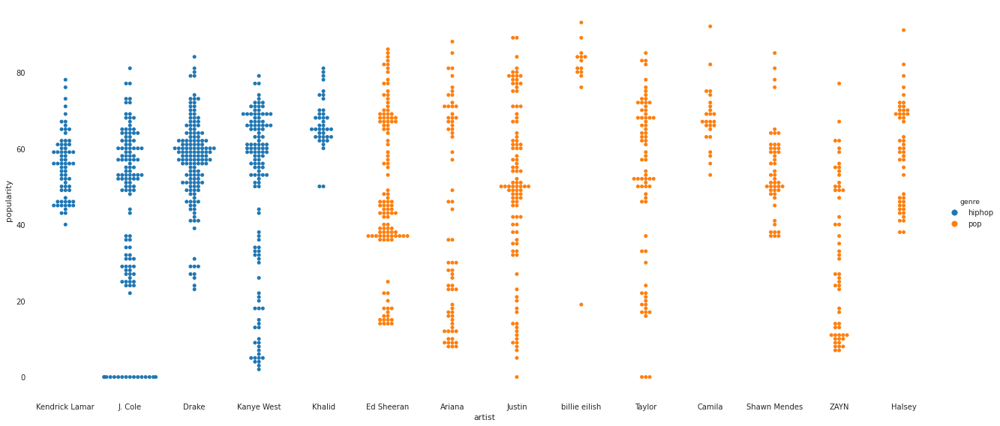

In [24]:
sns.catplot(x="artist", y="popularity", hue = "genre", 
            height = 8, aspect = 2.2, kind= "swarm", data=df_songs)

**Popularity of songs by explicit and mode.**

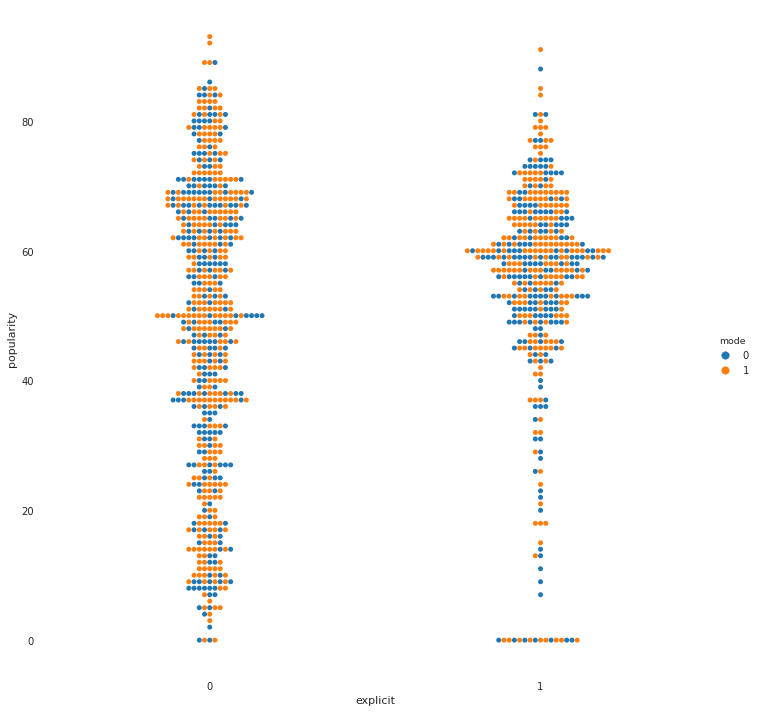

In [40]:
sns.catplot(x="explicit", y="popularity", hue = "mode", 
            height = 10, aspect = 1, kind= "swarm", data=df_songs)

**Kernel density estimation plots of popularity of hiphop and pop songs. These ridges are less smoothed than for a density plot.**

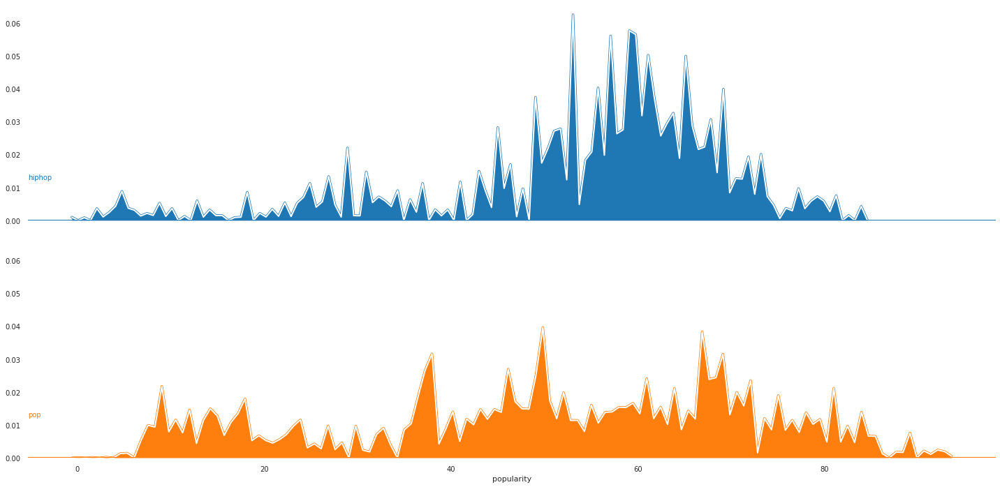

In [37]:
g = sns.FacetGrid(df_songs, row="genre", hue="genre", aspect=4, height=5)

# # Draw the densities in a few steps
g.map(sns.kdeplot, "popularity", shade=True, alpha=1, lw=3.5, bw=.2)
g.map(sns.kdeplot, "popularity", color="w", lw=2, bw=.2)
g.map(plt.axhline, y=0, lw=2)

# # Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color=color, ha="left", va="center", transform=ax.transAxes)
g.map(label, "popularity")

g.set_titles("")

# Visualizations and Analysis of Personality Sentiment

In [13]:
df_personality_sentiment.head()

,artist,album,name,explicit,genre,chain_lyrics,lyrics,polarity,magnitude,artistic,emotion,imagination,assertive,cheeful,outgoing,modesty,sympathy,fiery,melancholy
0,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Black Panther,1,hiphop,why i go easy \n know why i go easy \n wait \n...,why i go easy know why i go easy wait king of ...,-1.0,1.2,0.999983,0.931594,0.998384,0.095272,0.387043,0.101374,0.421143,0.985013,0.386352,0.921542
1,Kendrick Lamar,Black Panther The Album Music From And Inspire...,All The Stars,1,hiphop,love lets talk about love \n is it anything an...,love lets talk about love is it anything and e...,-1.0,1.3,0.996511,0.986234,0.991554,0.747748,0.986040,0.705842,0.441873,0.842244,0.157679,0.626636
2,Kendrick Lamar,Black Panther The Album Music From And Inspire...,I Am,1,hiphop,everybody put three fingers in the air \n the ...,everybody put three fingers in the air the sky...,-1.0,2.2,0.906971,0.318395,0.994980,0.574279,0.469771,0.320161,0.024560,0.785487,0.582447,0.669157
3,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Big Shot,1,hiphop,wakanda welcome \n big shot hol up wait peanut...,wakanda welcome big shot hol up wait peanut bu...,-1.0,1.3,0.967339,0.229457,0.975867,0.382183,0.880943,0.477181,0.000747,0.270318,0.787414,0.197281
4,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Pray For Me,1,hiphop,im always ready for a war again \n go down tha...,im always ready for a war again go down that r...,-1.0,1.1,0.980110,0.889895,0.977369,0.307116,0.962168,0.668731,0.864149,0.875111,0.464351,0.871338


In [51]:
profile = ProfileReport(df_personality_sentiment, 
                        title='Pandas Profiling Report', 
                        html={'style':{'full_width':True}})

In [52]:
profile.to_notebook_iframe()

**Taking a look at scatter plots between some features that had high correlation from above.**

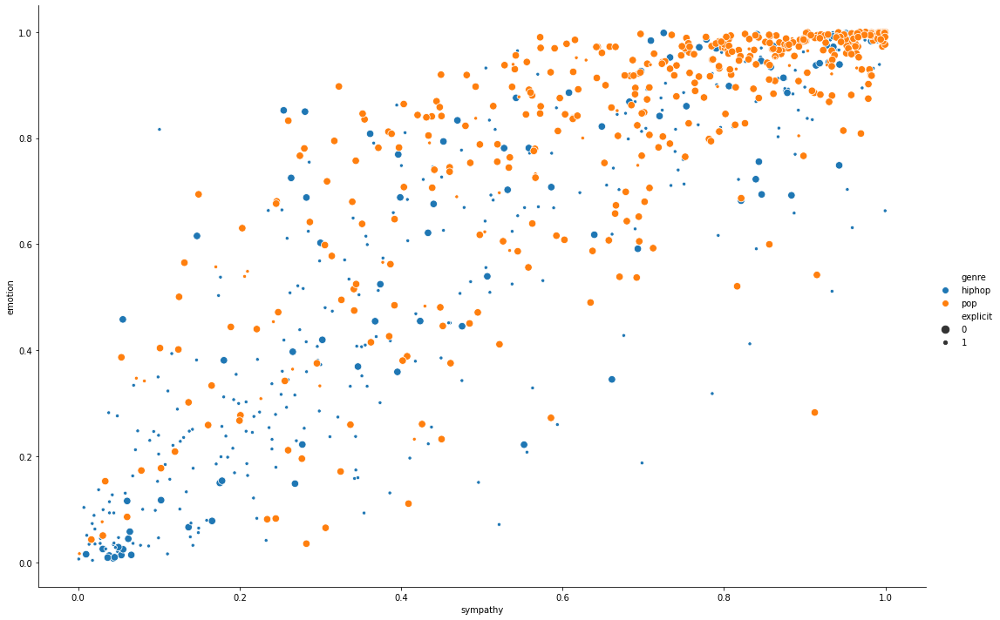

In [14]:
sns.relplot(x="sympathy", y="emotion", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_personality_sentiment)

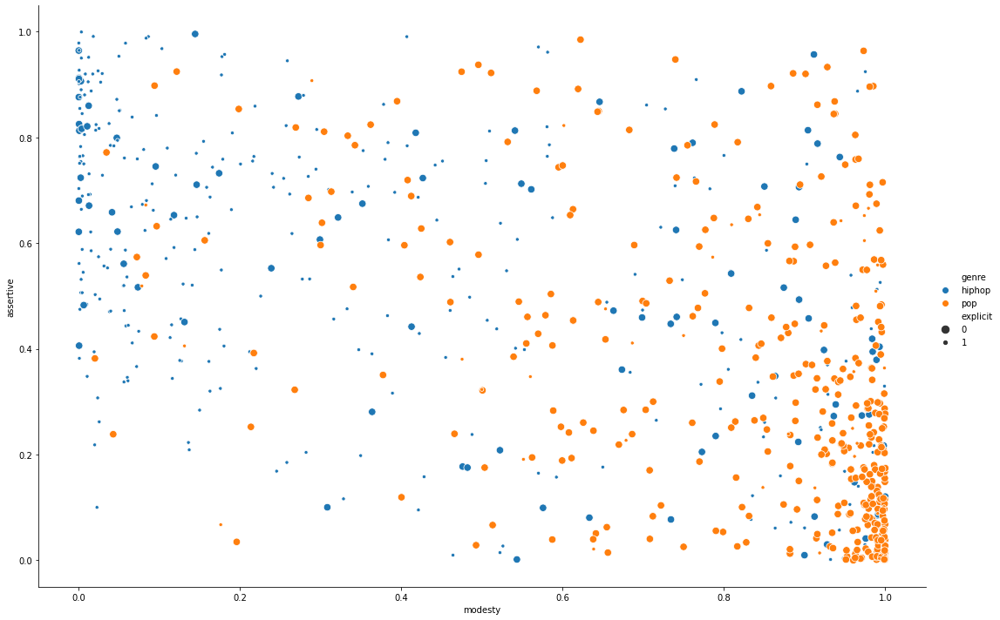

In [7]:
sns.relplot(x="modesty", y="assertive", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_personality_sentiment)

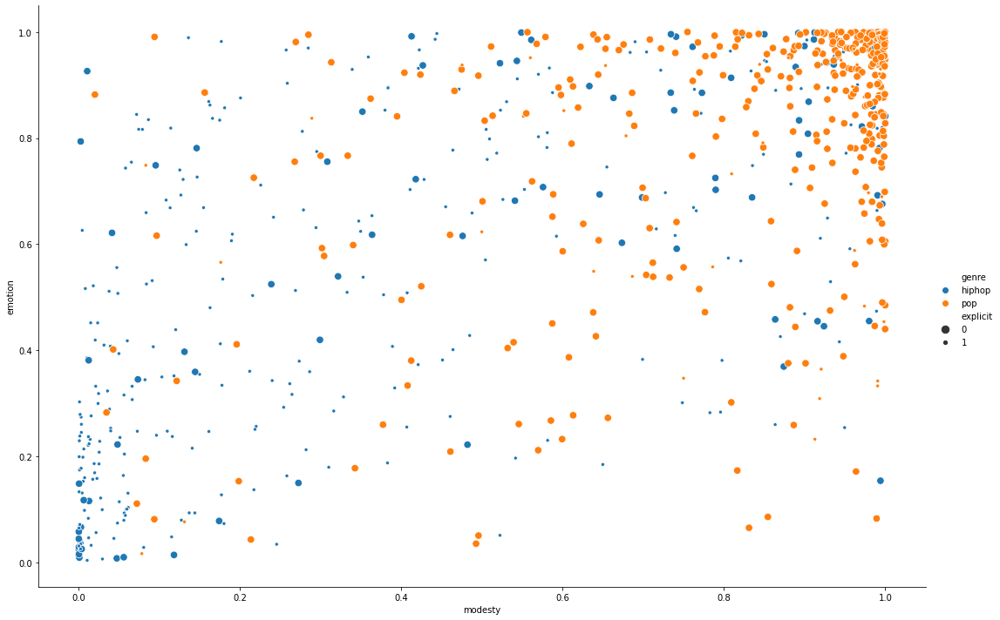

In [4]:
sns.relplot(x="modesty", y="emotion", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_personality_sentiment)

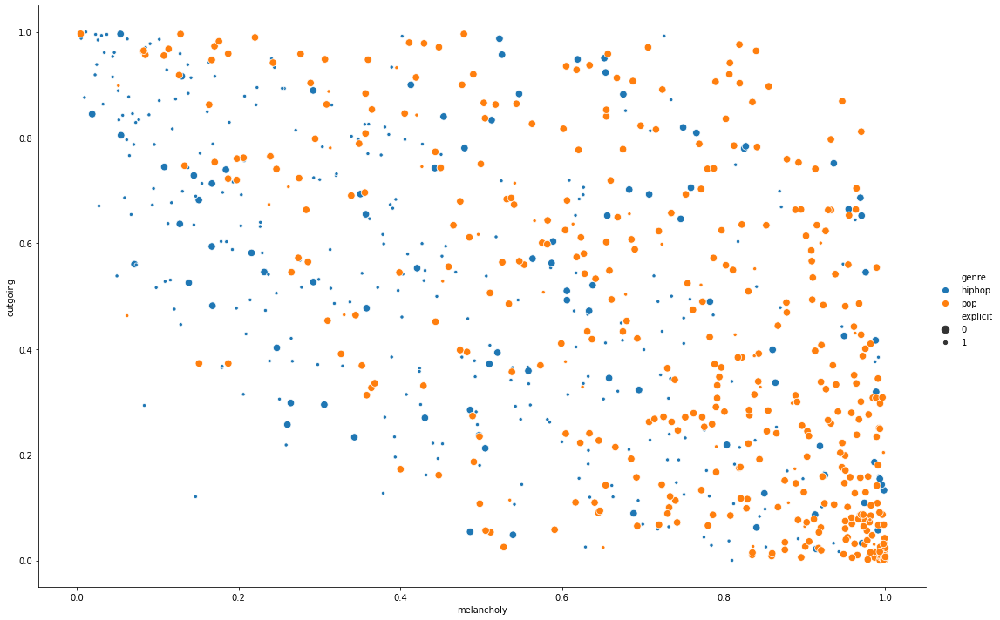

In [10]:
sns.relplot(x="melancholy", y="outgoing", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_personality_sentiment)

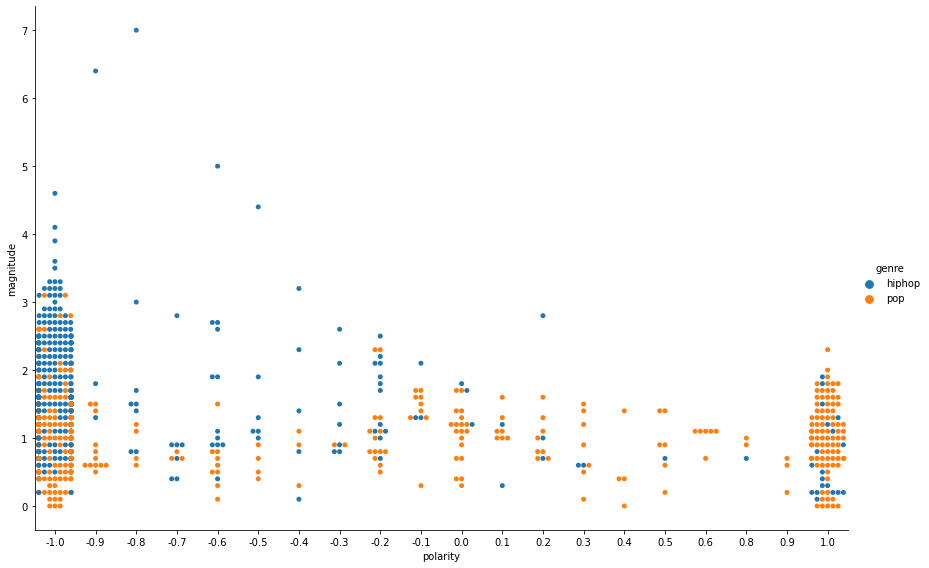

In [15]:
sns.catplot(x="polarity", y="magnitude", hue="genre", kind="swarm",
              height=8, aspect=1.5, data=df_personality_sentiment)

**Fiery is the only feature here that is right-skewed.**

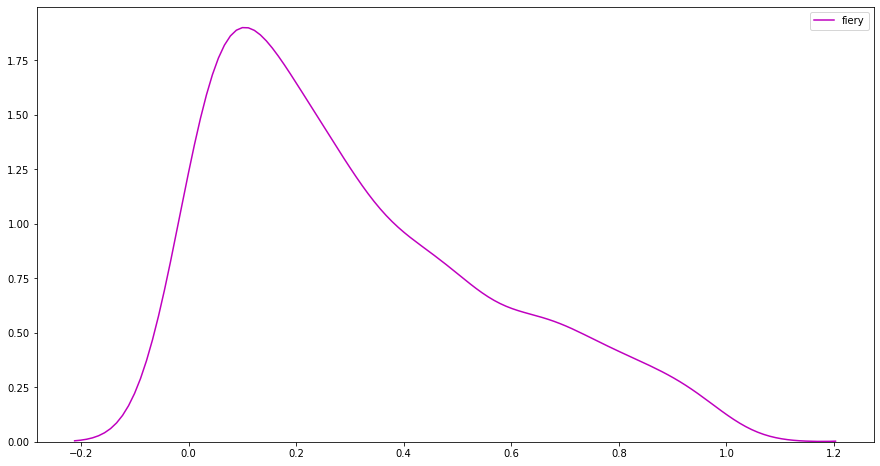

In [64]:
plt.figure(figsize=(15,8))
sns.kdeplot(df_personality_sentiment['fiery'], color="m")

**Artistic and cheerful are left-skewed.**

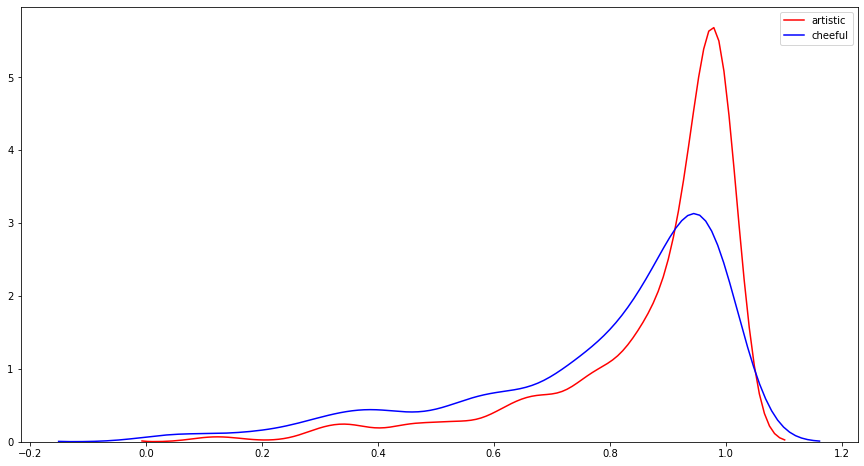

In [56]:
plt.figure(figsize=(15,8))
sns.kdeplot(df_personality_sentiment['artistic'], color="r")
sns.kdeplot(df_personality_sentiment["cheeful"], color="b")

**These features are also left-skewed a little.**

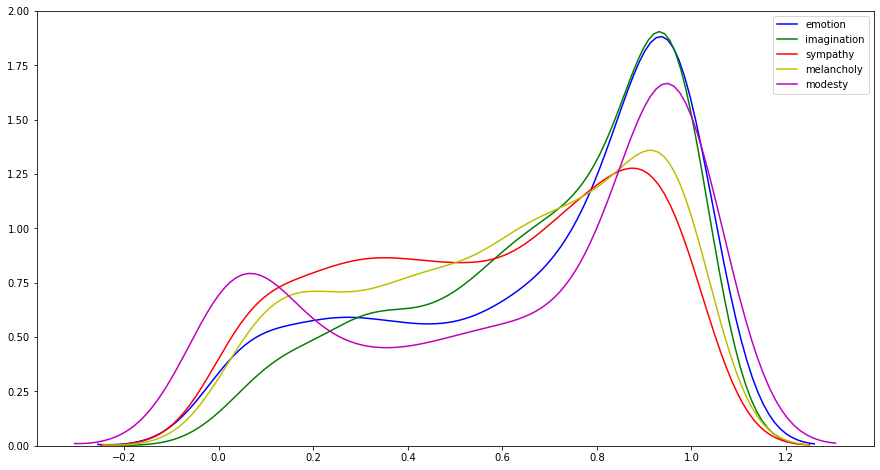

In [61]:
plt.figure(figsize=(15,8))
sns.kdeplot(df_personality_sentiment['emotion'], color="b")
sns.kdeplot(df_personality_sentiment['imagination'], color="g")
sns.kdeplot(df_personality_sentiment["sympathy"], color="r")
sns.kdeplot(df_personality_sentiment['melancholy'], color="y")
sns.kdeplot(df_personality_sentiment['modesty'], color="m")

**These features have like a plateau distribution.**

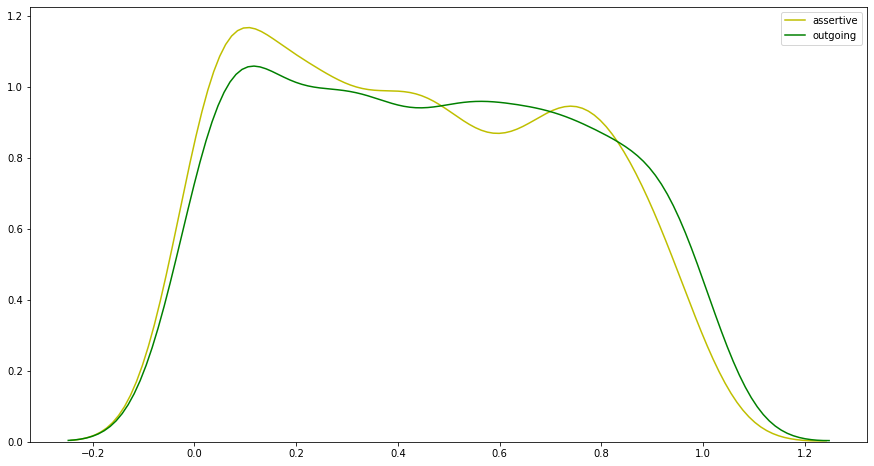

In [62]:
plt.figure(figsize=(15,8))
sns.kdeplot(df_personality_sentiment['assertive'], color="y")
sns.kdeplot(df_personality_sentiment['outgoing'], color="g")

# Analyzing the lyric text

**Thanks to Susan Li from Medium.**

In [0]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction import text

**Now I take a look at the inverse document frequency of bigrams and trigrams for hiphop songs and pop songs. I also use stop words.**

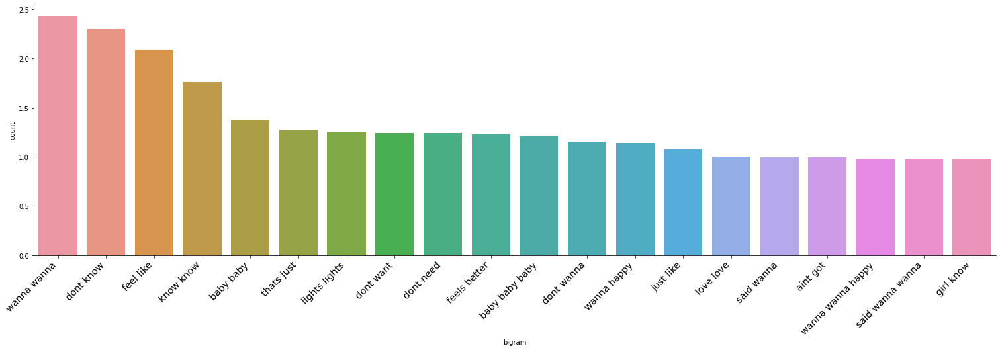

In [19]:
def get_top_n_words(corpus, n=None):
  my_stop_words = text.ENGLISH_STOP_WORDS.union(
      ["oh", "yeah", "im", "hey"])
  vec = TfidfVectorizer(
      ngram_range=(2, 3), stop_words=my_stop_words).fit(corpus)
  bag_of_words = vec.transform(corpus)
  sum_words = bag_of_words.sum(axis=0) 
  words_freq = [
          (word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
  words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
  return words_freq[:n]
common_words = get_top_n_words(
    df_personality_sentiment[
                    df_personality_sentiment["genre"]=="hiphop"]['lyrics'], 20)
df = pd.DataFrame(common_words, columns = ['bigram' , 'count'])
chart = sns.catplot(x="bigram", y="count", kind = "bar", 
            height = 6, aspect = 3.5,data=df)
chart.set_xticklabels(rotation=45, horizontalalignment='right', 
                      fontsize='x-large')

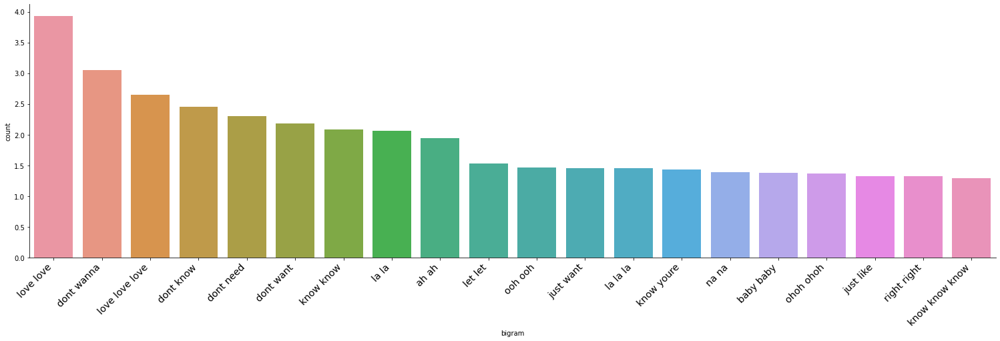

In [20]:
common_words = get_top_n_words(
    df_personality_sentiment[
                    df_personality_sentiment["genre"]=="pop"]['lyrics'], 20)
df = pd.DataFrame(common_words, columns = ['bigram' , 'count'])
chart = sns.catplot(x="bigram", y="count", kind = "bar", 
            height = 6, aspect = 3.5,data=df)
chart.set_xticklabels(rotation=45, horizontalalignment='right', 
                      fontsize='x-large')